In [ ]:
# NOTE Edit config.py to get num_recs=None, else you'll be restricted to ≤200 recs/sp
#   - Want: countries_k='na', com_names_k='us', num_recs=None,
#   - Not:  countries_k='na', com_names_k='us', num_recs=200,

In [ ]:
from notebooks import *
sg.init(None)  # Computes search_recs, if cache miss

INFO     [20:44:05.036] [56604] 154 logging_/<module>: {logging_yaml: None}

INFO     [20:44:05.463] [56604]  36 api.server_globals/init

DEBUG    [20:44:05.470] [56604]  84 api.server_globals/load: load_search...

INFO     [20:44:06.075] [56604]  88 api.server_globals/load: load_search (took 0.598s)

DEBUG    [20:44:06.083] [56604]  84 api.server_globals/load: load_xc_meta...

INFO     [20:44:06.893] [56604]  88 api.server_globals/load: load_xc_meta (took 0.801s)

DEBUG    [20:44:06.901] [56604]  84 api.server_globals/load: load_feat_info...

INFO     [20:44:06.908] [56604] 120 api.server_globals/load_feat_info

INFO     [20:44:06.915] [56604]  88 api.server_globals/load: load_feat_info (took 0.007s)

DEBUG    [20:44:06.922] [56604]  84 api.server_globals/load: load_search_recs...

INFO     [20:44:06.928] [56604] 128 api.server_globals/load_search_recs

INFO     [20:44:06.935] [56604] 602 api.recs/get_search_recs

INFO     [20:44:06.942] [56604] 152 payloads/df_cache_hybrid: Hit: payloads/search_recs-audio_s(10),version(8),com_names_k(us),countries_k(na),num_recs(None)-7fe4a7b

DEBUG    [20:44:06.953] [56604] 153 payloads/df_cache_hybrid: Hit ...

DEBUG    [20:44:06.963] [56604] 162 payloads/df_cache_hybrid: Hit: Read api/lite.parquet (75.9 MB) ...

INFO     [20:44:08.963] [56604] 169 payloads/df_cache_hybrid: Hit: Read api/lite.parquet (75.9 MB) [2.000s]

DEBUG    [20:44:08.981] [56604] 174 payloads/df_cache_hybrid: Hit: Read api/bytes-audio_bytes.parquet (2.1 GB) ...

INFO     [20:44:20.568] [56604] 181 payloads/df_cache_hybrid: Hit: Read api/bytes-audio_bytes.parquet (2.1 GB) [11.582s]

DEBUG    [20:44:20.679] [56604] 174 payloads/df_cache_hybrid: Hit: Read api/bytes-spectro_bytes.parquet (570.0 MB) ...

INFO     [20:44:21.782] [56604] 181 payloads/df_cache_hybrid: Hit: Read api/bytes-spectro_bytes.parquet (570.0 MB) [1.103s]

DEBUG    [20:44:21.794] [56604] 186 payloads/df_cache_hybrid: Hit: Read api/feat-f_preds.npy (155.5 MB) ...

INFO     [20:44:21.922] [56604] 188 payloads/df_cache_hybrid: Hit: Read api/feat-f_preds.npy (155.5 MB) [float32, 0.128s]

DEBUG    [20:44:22.187] [56604] 186 payloads/df_cache_hybrid: Hit: Read api/feat-feat.npy (315.7 MB) ...

INFO     [20:44:22.415] [56604] 188 payloads/df_cache_hybrid: Hit: Read api/feat-feat.npy (315.7 MB) [float32, 0.227s]

INFO     [20:44:22.422] [56604] 191 payloads/df_cache_hybrid: Hit: Join lite + bytes + feats

INFO     [20:44:23.064] [56604] 202 payloads/df_cache_hybrid: Hit [16.112s]

,dir,file,size,frac
5,api,TOTAL,3225111245,1.000
1,api,api/bytes-audio_bytes.parquet,2108033743,0.654
2,api,api/bytes-spectro_bytes.parquet,569952021,0.177
4,api,api/feat-feat.npy: float32,315678128,0.098
3,api,api/feat-f_preds.npy: float32,155524156,0.048
0,api,api/lite.parquet,75923197,0.024


INFO     [20:44:23.137] [56604]  88 api.server_globals/load: load_search_recs (took 16.208s)

INFO     [20:44:23.145] [56604]  38 api.server_globals/init: done

In [ ]:
search_recs = sg.search_recs

In [ ]:
# Utils

def _recs_show(
    df,
    scale=None,
    order=[
        'xc_id', 'spectro_disp',
        'species', 'subspecies',
        'year', 'month_day', 'time',
        'type',
        'state', 'elevation', 'lat', 'lng', 'place',
        'remarks',
        'quality', 'recordist', 'background_species', 'date',
    ],
    drop=['license', 'bird_seen', 'playback_used'],
    astype={'year': int},
    replace={'subspecies': {'': '—'}},
    **kwargs,
):
    return (df
        # Drop any indexes (e.g. from filter/sort)
        .reset_index(drop=True)
        # Featurize
        .pipe(recs_featurize_spectro_disp, scale=scale)
        # View
        .pipe(recs_view_cols, append=order)  # append= to ensure all requested cols are included
        .pipe(df_reorder_cols, last=order)  # last= so that unknown cols show up loudly in the front
        .drop(columns=drop)
        .astype(astype)
        .replace(replace)
    )

# XXX Very slow to run over all 45k recs, do lazily instead
# recs = (search_recs
#     .pipe(df_inspect, lambda df: (df.shape,))
#     .pipe(_recs_show)
#     .pipe(df_inspect, lambda df: (df.shape,))
# )

---

In [ ]:
# Copy selected audio/spectro files to talk dir
for sp, xc_id, desc in [
    ('WREN', 90158, 'male-and-female'),
    ('PSFL', 348155, 'dawn-song'),
    ('PSFL', 348142, 'song'),
]:
    payload_id      = 'search_recs-audio_s(10),version(8),com_names_k(us),countries_k(na),num_recs(200)-4a07700'
    search_recs_dir = 'data/cache/payloads/%(payload_id)s/mobile-version(2)/search_recs' % locals()
    talk_dir        = os.path.expanduser('~/Desktop/mb-talk-data')
    shell(**locals(), cmd='''
        cp -v %(search_recs_dir)s/audio/%(sp)s/audio-%(sp)s-%(xc_id)s.mp4     %(talk_dir)s/%(sp)s-%(xc_id)s-%(desc)s.mp4
        cp -v %(search_recs_dir)s/spectro/%(sp)s/spectro-%(sp)s-%(xc_id)s.png %(talk_dir)s/%(sp)s-%(xc_id)s-%(desc)s.png
    ''')

# By gender
- WREN
- (More: GHOW, RWBL?)

(52613, 71)

(1, 71)

xc_id                                               spectro_disp species subspecies  year month_day time  type                      state  \
0  90158  df_cell_display(value=<IPython.core.display.HTML object>)    WREN          —  1999     03-29    ?  song  California, United States   

  elevation     lat      lng                                                                   place                              remarks quality  \
0      40 m  35.253 -120.876  Coon Creek Trail, Montana de Oro State Park, California, United States  Two males and a female or juvenile?       A   

          recordist background_species       date  
0  Thomas G. Graves                 [] 1999-03-29
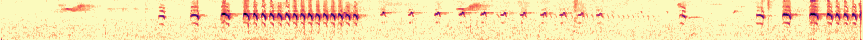

In [ ]:
# WREN
#   - [Pie19] p365
#       - Male song, female song, duet [verify]
#       - [PFGBS] https://academy.allaboutbirds.org/peterson-field-guide-to-bird-sounds/?speciesCode=wrenti
#   - [BNA] https://birdsna.org/Species-Account/bna/species/wrenti/sounds
#       - "A long (2–5 s) series of short, clear, overslurred whistles at about 4 kHz, accelerating into a rapid
#         chatter."
#       - "Female song is similar, but with an even rhythm, and with a highly variable number of notes (3–14)."
#       - "Number of introductory notes is variable, but typically 3–5 in the male song, and the quality of those notes
#         can vary with increasing agitation."
#       - "Partial male songs are common and sound identical to female songs."
#   - Recs
#       - WREN/90158 male and female (duet)
(search_recs
    .pipe(df_inspect, lambda df: (df.shape,))
    # Filter
    [lambda df: reduce(lambda x, y: x & y, [
        df.species == 'WREN',
        # df.remarks.str.lower().str.contains('female'),  # Not useful
        # df.remarks.str.lower().str.contains('slow'),  # Not useful
        # df.remarks.str.lower().str.contains('male'),  # Not useful
        df.xc_id.isin([90158]),
    ])]
    .pipe(df_inspect, lambda df: (df.shape,))
    # Sort
    .sort_values('date', ascending=False)
    # View
    .pipe(_recs_show,
        scale=3,
    )
    [:500]
)

# By age

(52613, 71)

(5, 71)

xc_id                                               spectro_disp species subspecies  year month_day   time            type  \
0  173877  df_cell_display(value=<IPython.core.display.HTML object>)    RTHA          —  2012     06-20  09:35     flight call   
1  173880  df_cell_display(value=<IPython.core.display.HTML object>)    RTHA          —  2012     10-28  13:29            call   
2   65409  df_cell_display(value=<IPython.core.display.HTML object>)    RTHA    calurus  2010     06-14  07:45       keer call   
3  187482  df_cell_display(value=<IPython.core.display.HTML object>)    RTHA          —  2014     07-16  10:30  call, juvenile   
4  139200  df_cell_display(value=<IPython.core.display.HTML object>)    RTHA   borealis  2013     06-18  16:30  call, juvenile   

                       state elevation     lat      lng                                                                      place  \
0     Florida, United States      20 m  27.937  -81.225  Joe Overstreet Rd, Lake Kissimmee, Osceola County, Florida, United States   
1  California, United States      10 m  32.555 -117.063               Dairymart Ponds, San Diego County, California, United States   
2  California, United States    1520 m  39.698 -120.453                    Carman Valley, Sierra County, California, United States   
3   British Columbia, Canada      90 m  48.490 -123.434                      Hector Rd, Vancouver Island, British Columbia, Canada   
4     Georgia, United States       3 m  31.887  -81.057                                  Savannah, Chatham, Georgia, United States   

                                                                                                                                                                                                   remarks  \
0                                                                                                                                                                                                            
1                                                                                                                                                                                        on telephone pole   
2                                                                                                                bird calling while perched atop tall conifer. also can hear Douglas's squirrel twittering   
3                                                                                                                                                Whistles from recently-fledged juvenile, given in flight.   
4  Amplification was boosted.  The original recording was shortened to exclude nearby construction noise.  The intervals between the calls are as recorded.  The two fledglings were following a parent...   

    quality        recordist  background_species       date  
0         B      Paul Marvin  [EAME, NOBO, COYE] 2012-06-20  
1         B      Paul Marvin                  [] 2012-10-28  
2         A     Eric DeFonso        [MODO, AMRO] 2010-06-14  
3  no score  Ian Cruickshank                  [] 2014-07-16  
4         A        Russ Wigh              [BTGR] 2013-06-18
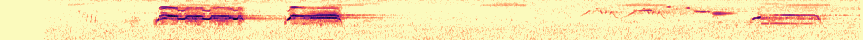
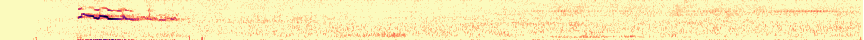
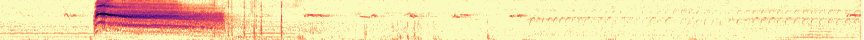
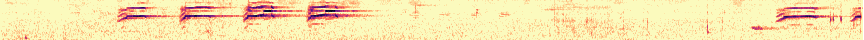
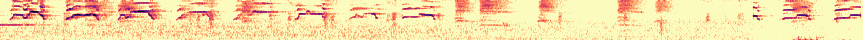

In [ ]:
# RTHA
#   - [Pie19] p205
#       - Squeal: "Given by immature birds in their first summer and fall... May transition gradually into adult Scream
#         over course of first fall and winter; more study needed."
#   - Recs
#       - RTHA/187482 - squeal (juv) - clean
#       - RTHA/139200 - squeal (juv) - messy
#       - RTHA/65409  - scream (adult) - clean
#       - RTHA/173877 - transitional squeal/scream [good]
#       - RTHA/173880 - transitional squeal/scream [good, but too quiet]
(search_recs
    .pipe(df_inspect, lambda df: (df.shape,))
    # Filter
    [lambda df: reduce(lambda x, y: x & y, [
        df.species == 'RTHA',
        df.xc_id.isin([187482, 139200, 65409, 173877, 173880]),
    ])]
    .pipe(df_inspect, lambda df: (df.shape,))
    # Sort
    # .sample(frac=1, random_state=0)
    # [lambda df: ~df.subspecies.isin([''])].sort_values(['subspecies'], ascending=[True])
    # .sort_values('month_day')
    # View
    .pipe(_recs_show,
        scale=3,
    )
    # [:100]
)

# By time of day

(52613, 71)

(2, 71)

xc_id                                               spectro_disp species  subspecies  year month_day   time                type  \
0  348155  df_cell_display(value=<IPython.core.display.HTML object>)    PSFL  cineritius  2001     06-15  05:20           dawn song   
1  348142  df_cell_display(value=<IPython.core.display.HTML object>)    PSFL  cineritius  2001     06-15  05:25  male position note   

                     state elevation    lat      lng                                                               place  \
0  Baja California, Mexico    2300 m  30.98 -115.504  La Corona Arriba, Sierra San Pedro Martir, Baja California, Mexico   
1  Baja California, Mexico    2300 m  30.98 -115.504  La Corona Arriba, Sierra San Pedro Martir, Baja California, Mexico   

                                                                     remarks quality           recordist        background_species       date  
0  territory No 1, 3rd recording; some interaction type notes toward the end       B  Richard E. Webster              [MOCH, ACWO] 2001-06-15  
1            territory No 1 recorded here, 4th recording; male position note       A  Richard E. Webster  [MOCH, DEJU, WBNU, PYNU] 2001-06-15
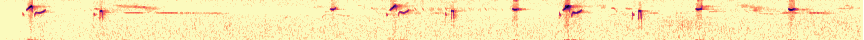
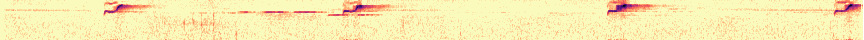

In [ ]:
# PSFL: dawn song vs. normal song
#   - [Pie19] p272
#       - Dawn song, normal song
#       - (No "dawn" at [PFGBS] https://academy.allaboutbirds.org/peterson-field-guide-to-bird-sounds/?speciesCode=pasfly)
#   - [BNA] https://birdsna.org/Species-Account/bna/species/pasfly/sounds
#       - Same as [Pie19]
#   - Recs
#       - PSFL/348155 dawn song
#       - PSFL/348142 song
(search_recs
    .pipe(df_inspect, lambda df: (df.shape,))
    # Filter
    [lambda df: reduce(lambda x, y: x & y, [
        df.species == 'PSFL',
        df.recordist.str.lower().str.match(r'.*webster.*'),
        df.xc_id.isin([348155, 348142]),
    ])]
    .pipe(df_inspect, lambda df: (df.shape,))
    # Sort
    # .sort_values(['subspecies', 'lat'], ascending=[True, False])
    # .sort_values(['lat'], ascending=False)
    # .sort_values(['lng'], ascending=True)
    .sort_values(['time'], ascending=True)
    # View
    .pipe(_recs_show,
        scale=3,
    )
    [:500]
)

# Within one individual

(52613, 71)

(179, 71)

xc_id                                               spectro_disp species   subspecies  year month_day   time          type  \
0   402932  df_cell_display(value=<IPython.core.display.HTML object>)    HUVI            —  2018     02-14  08:19          call   
1   412615  df_cell_display(value=<IPython.core.display.HTML object>)    HUVI            —  2018     04-08  16:42          call   
2    92953  df_cell_display(value=<IPython.core.display.HTML object>)    HUVI            —  2008     04-30  08:55          song   
3   156192  df_cell_display(value=<IPython.core.display.HTML object>)    HUVI            —  2011     06-10  15:00          song   
4   183585  df_cell_display(value=<IPython.core.display.HTML object>)    HUVI            —  2014     06-24  07:00          song   
5   405621  df_cell_display(value=<IPython.core.display.HTML object>)    HUVI            —  2018     03-11  14:05          song   
6   232139  df_cell_display(value=<IPython.core.display.HTML object>)    HUVI            —  2001     03-11  12:00         call?   
7    30595  df_cell_display(value=<IPython.core.display.HTML object>)    HUVI    stephensi  2009     02-15  09:00          song   
8   323414  df_cell_display(value=<IPython.core.display.HTML object>)    HUVI    stephensi  2015     05-31  11:15          song   
9   125471  df_cell_display(value=<IPython.core.display.HTML object>)    HUVI            —  2013     03-17  09:25          song   
10  296985  df_cell_display(value=<IPython.core.display.HTML object>)    HUVI            —  2011     06-22  10:56          song   
11  282857  df_cell_display(value=<IPython.core.display.HTML object>)    HUVI            —  2015     03-04  16:30    male, song   
12  252186  df_cell_display(value=<IPython.core.display.HTML object>)    HUVI            —  2015     06-10  08:30          song   
13  413985  df_cell_display(value=<IPython.core.display.HTML object>)    HUVI            —  2018     05-06  08:00          call   
14  365405  df_cell_display(value=<IPython.core.display.HTML object>)    HUVI    mexicanus  2017     03-25  07:00          call   
15  297611  df_cell_display(value=<IPython.core.display.HTML object>)    HUVI            —  2012     07-25  08:44          song   
16  212822  df_cell_display(value=<IPython.core.display.HTML object>)    HUVI  oberholseri  2015     02-07  15:30          call   
17  282597  df_cell_display(value=<IPython.core.display.HTML object>)    HUVI    stephensi  2015     08-14  08:30    call, song   
18  105702  df_cell_display(value=<IPython.core.display.HTML object>)    HUVI     cognatus  2008     07-15   1100  excited song   
19  256398  df_cell_display(value=<IPython.core.display.HTML object>)    HUVI            —  2014     03-28      ?          song   
20  358938  df_cell_display(value=<IPython.core.display.HTML object>)    HUVI            —  2017     03-06  12:00          call   
21  168038  df_cell_display(value=<IPython.core.display.HTML object>)    HUVI            —  2014     02-23  08:00          call   
22  324079  df_cell_display(value=<IPython.core.display.HTML object>)    HUVI            —  2015     05-01  09:29          song   
23   73497  df_cell_display(value=<IPython.core.display.HTML object>)    HUVI            —  2011     03-15  08:30          Song   
24  283520  df_cell_display(value=<IPython.core.display.HTML object>)    HUVI    stephensi  2015     08-14  12:05          song   

                                             state      elevation     lat      lng  \
0                           Arizona, United States         1800 m  32.373 -110.695   
1             Cerro Alto Campground, United States          340 m  35.424 -120.737   
2                                TX, United States         1900 m  30.657 -104.151   
3                         British Columbia, Canada          420 m  48.461 -123.653   
4                         British Columbia, Canada           80 m  48.496 -123.433   
5                        California, United States         1300 m  34.225 -117.681
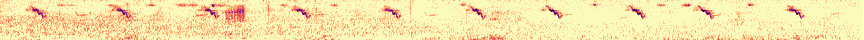
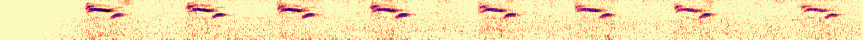
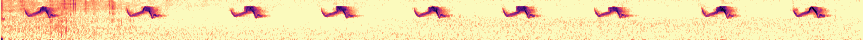
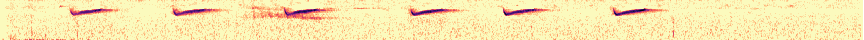
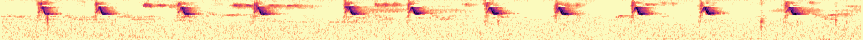
...
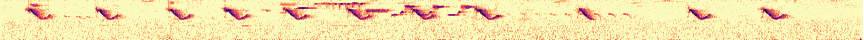
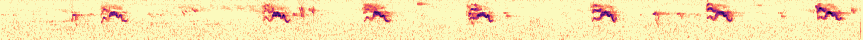
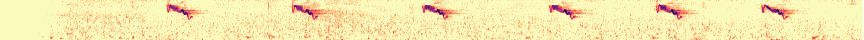
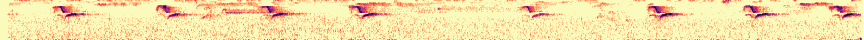
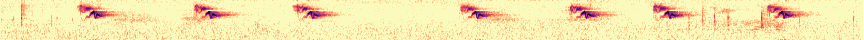

In [ ]:
# HUVI
#   - [Pie19] p297
#       - "Phrases vary tremendously"
#       - "Incessant repetition of the same sound can be an excellent field mark, but singing occasionally deviates from
#         this pattern"
#   - [BNA] https://birdsna.org/Species-Account/bna/species/hutvir/sounds
#       - "Much individual and geographic variation"
#       - "Typical song pattern is a monotonous and unmusical series of nasal and wheezy 2-syllable, ascending phrases
#         ... repeated approximately 1 per second for a period sometimes spanning ≥ 10 min"
#       - "A common variation is composed of descending phrases"
#       - "A bird may sing either form, may alternate between the 2 forms, and occasionally may mix ascending and
#         descending phrases in the same series ... producing a pattern reminiscent of the song of Cassin's Vireo"
(search_recs
    .pipe(df_inspect, lambda df: (df.shape,))
    # Filter
    [lambda df: reduce(lambda x, y: x & y, [
        df.species == 'HUVI',
    ])]
    .pipe(df_inspect, lambda df: (df.shape,))
    # Sort
    .sample(frac=1, random_state=2)
    # View
    .pipe(_recs_show,
        scale=3,
    )
    [:25]
)

# By time of year (season)
- Omitted: not worthwhile given the ones we already have above
    - YRWA - visually similar to WIWA, doesn't add much
    - HETH - takes a moment to see
    - RCKI - hard to visually parse

In [ ]:
def _show_seasonal(
    species,
    filters=lambda df: [],
    bins=2,  # 2 | 4
    n=None,
    scale=None,
    scale_base=3.8,
    random_state=0,
):
    assert bins in [2, 4]
    if n is None:
        n = 50 // bins
    return (search_recs
        .pipe(df_inspect, lambda df: (df.shape,))
        # Filter
        [lambda df: reduce(lambda x, y: x & y, [
            df.species == species,
            *filters(df),
        ])]
        .pipe(df_inspect, lambda df: (df.shape,))
        # Sort
        # .sample(100, random_state=random_state)
        .sort_values(['month_day'], ascending=[False])
        # View
        .pipe(_recs_show,
            scale=scale or scale_base / bins,
        )
        [:1000]  # Safeguard: trim to a reasonable max (> any sp, but << all recs)
        # Bin by season (4 bins)
        #   - Boundaries based roughly on https://birdsna.org/Species-Account/bna/species/ruckin/breeding
        .assign(season=lambda df: df.month_day.str.split('-').str[0].map(lambda x: {
            '09': 'fall migration',
            '10': 'fall migration',
            '11': 'fall migration',
            '12': 'winter',
            '01': 'winter',
            '02': 'winter',
            '03': 'spring migration',
            '04': 'spring migration',
            '05': 'spring migration',
            '06': 'breeding',
            '07': 'breeding',
            '08': 'breeding',
        }.get(x)))
        .assign(season=lambda df: df.season.pipe(lambda s: s.pipe(as_ordered_cat, [
            'fall migration', 'winter', 'spring migration', 'breeding',
        ])))
        # Bin further
        #   - For bigger spectros (4->2 cols)
        .pipe(lambda df: df if bins == 4 else (df
            .replace({'season': {
                'spring migration': 'spring migration / breeding',
                'breeding':         'spring migration / breeding',
                'fall migration':   'fall migration / winter',
                'winter':           'fall migration / winter',
            }})
            .assign(season=lambda df: df.season.pipe(lambda s: s.pipe(as_ordered_cat, [
                'fall migration / winter', 'spring migration / breeding',
            ])))
        ))
        # Pivot by season (manually)
        .pipe(lambda df: pd.concat(axis=1, objs=[
            (df
                [df.season == season]
                [['spectro_disp']]
                .rename(columns={'spectro_disp': season})
                .sample(frac=1, random_state=random_state)  # Randomize per column (to avoid weird biases from incidental sorting above)
                .reset_index(drop=True)
            )
            for season in df.season.sort_values().unique()
        ]))
        .fillna('')
        .pipe(df_inspect, lambda df: (df.shape,))
        [:n]
        .pipe(df_inspect, lambda df: (df.shape,))
    )

(52613, 71)

(204, 71)

(180, 2)

(25, 2)

fall migration / winter                                spring migration / breeding
0   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
1   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
2   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
3   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
4   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
5   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
6   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
7   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
8   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
9   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
10  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
11  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
12  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
13  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
14  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
15  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
16  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
17  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
18  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
19  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
20  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
21  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
22  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
23  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
24                                                             df_cell_display(value=<IPython.core.display.HTML object>)
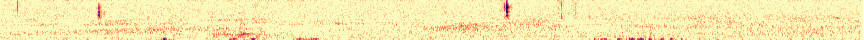
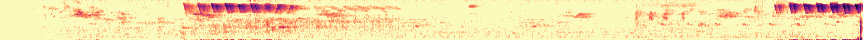
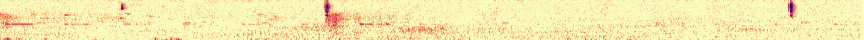
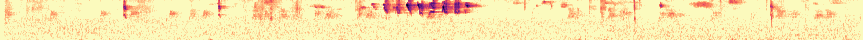
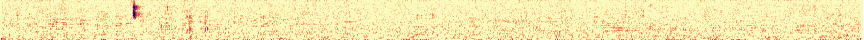
...
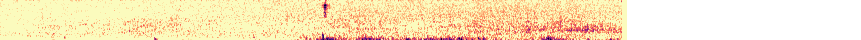
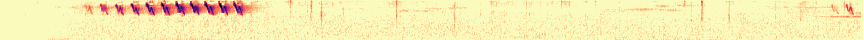
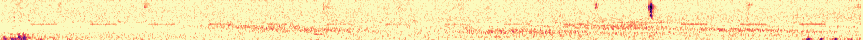
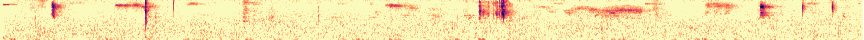
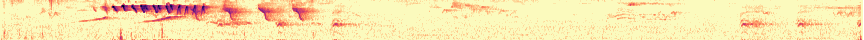

In [ ]:
# Good: visually apparent
_show_seasonal('WIWA')

(52613, 71)

(521, 71)

(429, 2)

(25, 2)

fall migration / winter                                spring migration / breeding
0   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
1   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
2   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
3   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
4   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
5   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
6   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
7   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
8   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
9   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
10  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
11  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
12  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
13  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
14  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
15  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
16  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
17  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
18  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
19  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
20  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
21  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
22  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
23  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
24  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
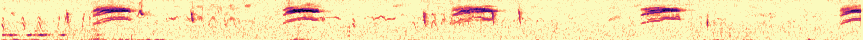
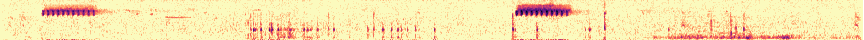
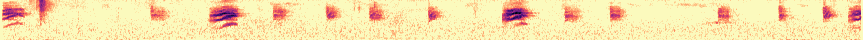
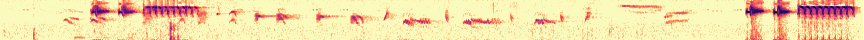
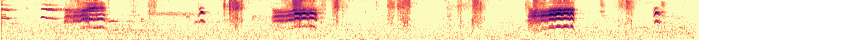
...
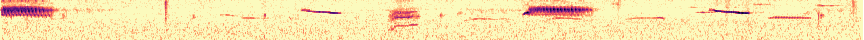
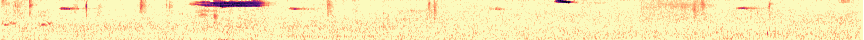
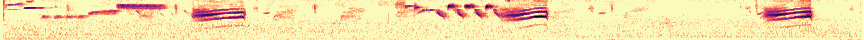
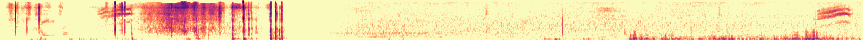
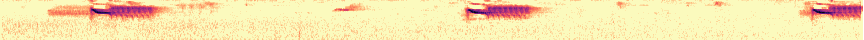

In [ ]:
# Good
#   - Take a moment to explain wraa calls on the left vs. trill songs on the right
_show_seasonal('SPTO')

(52613, 71)

(501, 71)

(391, 2)

(25, 2)

fall migration / winter                                spring migration / breeding
0   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
1   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
2   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
3   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
4   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
5   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
6   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
7   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
8   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
9   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
10  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
11  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
12  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
13  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
14  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
15  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
16  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
17  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
18  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
19  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
20  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
21  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
22  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
23  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
24  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
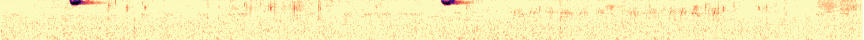
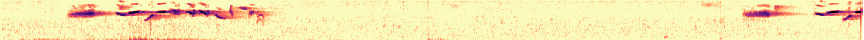
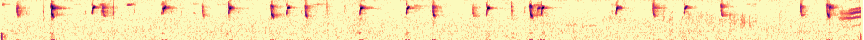
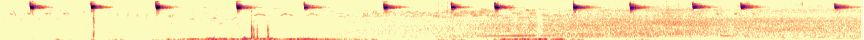
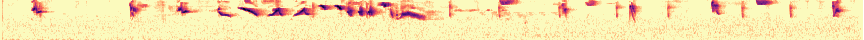
...
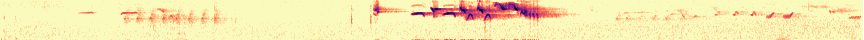
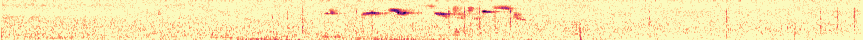
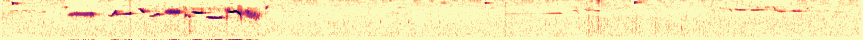
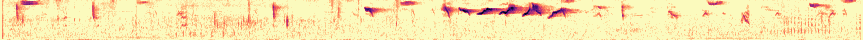
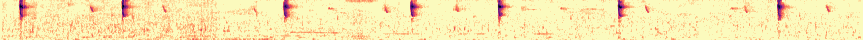

In [ ]:
# Good
#   - Take a moment to explain chips on the left vs. songs on the right
show_seasonal('FOSP')

(52613, 71)

(648, 71)

(498, 2)

(25, 2)

fall migration / winter                                spring migration / breeding
0   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
1   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
2   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
3   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
4   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
5   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
6   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
7   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
8   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
9   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
10  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
11  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
12  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
13  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
14  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
15  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
16  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
17  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
18  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
19  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
20  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
21  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
22  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
23  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
24  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
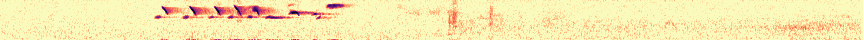
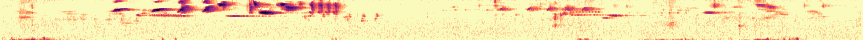
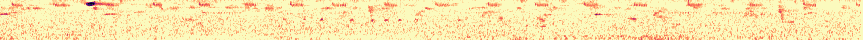
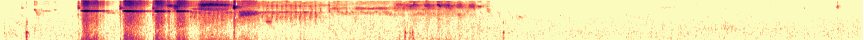
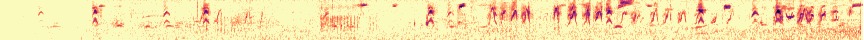
...
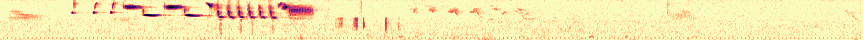
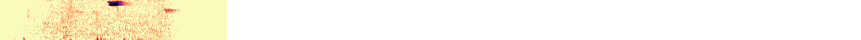
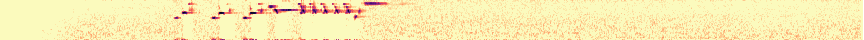
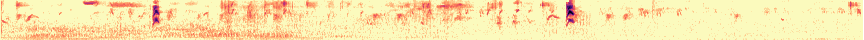
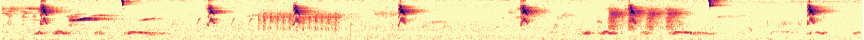

In [ ]:
# [Skippable]
# Good example of partial switch
#   - [Pie19] "All year, but mostly Mar—Aug"
_show_seasonal('SOSP')

# By subspecies (/ geography)

In [ ]:
def _show_seasonal(
    species,
    filters=lambda df: [],
    bins=2,  # 2 | 4
    n=None,
    scale=None,
    scale_base=3.8,
    random_state=0,
):
    assert bins in [2, 4]
    if n is None:
        n = 50 // bins
    return (search_recs
        .pipe(df_inspect, lambda df: (df.shape,))
        # Filter
        [lambda df: reduce(lambda x, y: x & y, [
            df.species == species,
            *filters(df),
        ])]
        .pipe(df_inspect, lambda df: (df.shape,))
        # Sort
        # .sample(100, random_state=random_state)
        .sort_values(['month_day'], ascending=[False])
        # View
        .pipe(_recs_show,
            scale=scale or scale_base / bins,
        )
        [:1000]  # Safeguard: trim to a reasonable max (> any sp, but << all recs)
        # Bin by season (4 bins)
        #   - Boundaries based roughly on https://birdsna.org/Species-Account/bna/species/ruckin/breeding
        .assign(season=lambda df: df.month_day.str.split('-').str[0].map(lambda x: {
            '09': 'fall migration',
            '10': 'fall migration',
            '11': 'fall migration',
            '12': 'winter',
            '01': 'winter',
            '02': 'winter',
            '03': 'spring migration',
            '04': 'spring migration',
            '05': 'spring migration',
            '06': 'breeding',
            '07': 'breeding',
            '08': 'breeding',
        }.get(x)))
        .assign(season=lambda df: df.season.pipe(lambda s: s.pipe(as_ordered_cat, [
            'fall migration', 'winter', 'spring migration', 'breeding',
        ])))
        # Bin further
        #   - For bigger spectros (4->2 cols)
        .pipe(lambda df: df if bins == 4 else (df
            .replace({'season': {
                'spring migration': 'spring migration / breeding',
                'breeding':         'spring migration / breeding',
                'fall migration':   'fall migration / winter',
                'winter':           'fall migration / winter',
            }})
            .assign(season=lambda df: df.season.pipe(lambda s: s.pipe(as_ordered_cat, [
                'fall migration / winter', 'spring migration / breeding',
            ])))
        ))
        # Pivot by season (manually)
        .pipe(lambda df: pd.concat(axis=1, objs=[
            (df
                [df.season == season]
                [['spectro_disp']]
                .rename(columns={'spectro_disp': season})
                .sample(frac=1, random_state=random_state)  # Randomize per column (to avoid weird biases from incidental sorting above)
                .reset_index(drop=True)
            )
            for season in df.season.sort_values().unique()
        ]))
        .fillna('')
        .pipe(df_inspect, lambda df: (df.shape,))
        [:n]
        .pipe(df_inspect, lambda df: (df.shape,))
    )

(52613, 71)

(432, 71)

(432, 71)

(230, 2)

(25, 2)

W -117 (coastal CA)                                          E -110 (CO/AZ/MX)
0   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
1   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
2   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
3   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
4   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
5   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
6   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
7   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
8   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
9   df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
10  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
11  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
12  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
13  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
14  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
15  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
16  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
17  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
18  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
19  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
20  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
21  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
22  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
23  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
24  df_cell_display(value=<IPython.core.display.HTML object>)  df_cell_display(value=<IPython.core.display.HTML object>)
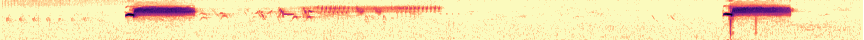
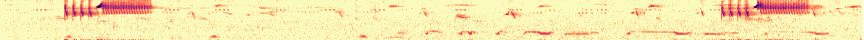
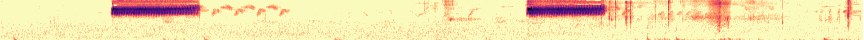
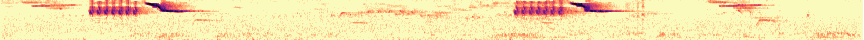
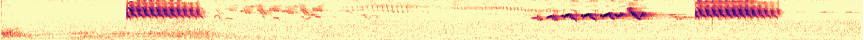
...
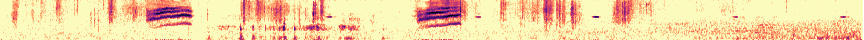
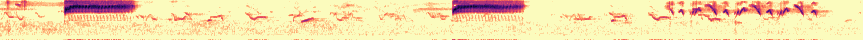
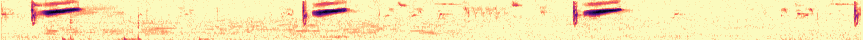
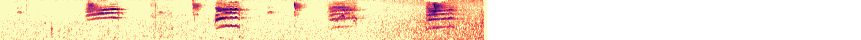
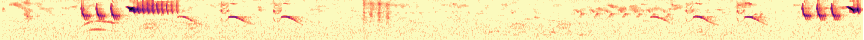

In [ ]:
# SPTO
#   - [Pie19] p425
#       - "Typical version: 2 unmusical series or trills, second higher"
#       - "West Coast version: single long buzz"
#   - [BNA] https://birdsna.org/Species-Account/bna/species/spotow/sounds
#       - "Interior males sing songs generally containing both introductory and trill phrases, while coastal birds usually
#         sing only trills."
#       - Far western (coastal) birds trill faster on average than interior (mountain, plains) western birds, but trill
#         rates are variable and largely overlapping (15.4–32.3 syll/s vs. 14.5–21.3 syll/s)
#   - [BNA] https://birdsna.org/Species-Account/bna/species/spotow/systematics
#       - 21 subsp (see map)
#       - Various isolated subsp in the southern end of range (MX)
(search_recs
    .pipe(df_inspect, lambda df: (df.shape,))
    # Filter
    [lambda df: reduce(lambda x, y: x & y, [
        df.species == 'SPTO',
        # df.type.str.lower().str.match(r'.*song.*'),
        # df.type.str.lower().str.match(r'^song$'),
        df.quality.isin(['A', 'B']),
    ])]
    .pipe(df_inspect, lambda df: (df.shape,))
    # Sort
    # .sample(250, random_state=0)
    # .sample(50, random_state=0)
    # .sort_values(['subspecies', 'lat'], ascending=False)
    # .sort_values(['lat'], ascending=False)
    # .sort_values(['lng'], ascending=True)
    .pipe(df_inspect, lambda df: (df.shape,))
    # View
    .pipe(_recs_show,
        scale=1.9,
    )

    # Bin by geo (2 bins)
    #   - Very rough, but decent results

    # .assign(geo=lambda df: df.state.str.lower().str.replace('.', '').str.split(r',\s*').map(lambda states: first(
    #     [
    #         geo
    #         for state in states
    #         for geo in [{
    #
    #             # # 'british columbia': 'west coast',
    #             # # 'bc':               'west coast',
    #             # # 'washington':       'west coast',
    #             # # 'wa':               'west coast',
    #             # # 'oregon':           'west coast',
    #             # 'california':       'west coast',
    #             # 'ca':               'west coast',
    #             # # 'inyo county':      'interior',  # Right? (Inyo County ~ Death Valley, CA)
    #             # # 'colorado':         'interior',
    #             # # 'utah':             'interior',
    #             # 'arizona':          'interior',
    #             # 'az':               'interior',
    #             # 'new mexico':       'interior',
    #             # # 'mexico':           'interior',
    #
    #             # 'british columbia': 'west coast',
    #             # 'bc':               'west coast',
    #             # 'washington':       'west coast',
    #             # 'wa':               'west coast',
    #             # 'oregon':           'west coast',
    #             'california':       'california',
    #             'ca':               'california',
    #             # 'inyo county':      'interior',  # Right? (Inyo County ~ Death Valley, CA)
    #             'colorado':         'colorado',
    #             # 'utah':             'interior',
    #             # 'arizona':          'arizona',
    #             # 'az':               'arizona',
    #             # # 'new mexico':       'new mexico',
    #             # 'mexico':           'mexico',
    #
    #         }.get(state)]
    #         if geo is not None
    #     ] + [
    #         None,
    #     ]
    # )))

    .assign(geo=lambda df: df.pipe(df_map_rows, lambda row: (
        'W -117 (coastal CA)' if row.lng < -117 else  # -117 to exclude Inyo County (Death Valley) which behaves ~like interior
        'E -110 (CO/AZ/MX)'   if row.lng > -110 else  # -110 to include CO/AZ/MX (at least)
        None                                          # Throw out everything in the middle, to simplify analysis
    )))

    [lambda df: df.geo.notnull()]
    .assign(geo=lambda df: df.geo.pipe(lambda s: s.pipe(as_ordered_cat, [
        # 'west coast', 'interior',
        # 'california', 'colorado', 'arizona', 'mexico',
        # 'california', 'colorado',
        'W -117 (coastal CA)', 'E -110 (CO/AZ/MX)',
    ])))
    # .pipe(df_inspect, lambda df: df[:250])  # Debug

    # Pivot by geo (manually)
    .pipe(lambda df: pd.concat(axis=1, objs=[
        (df
            [df.geo == geo]
            [['spectro_disp']]
            .rename(columns={'spectro_disp': geo})
            .sample(frac=1, random_state=0)  # Randomize per column (to avoid weird biases from incidental sorting above)
            .reset_index(drop=True)
        )
        for geo in df.geo.sort_values().unique()
    ]))
    .fillna('')
    .pipe(df_inspect, lambda df: (df.shape,))
    [:25]
    .pipe(df_inspect, lambda df: (df.shape,))

)

# Final quiz
- (All the damn wraa calls)

In [ ]:
# To search for examples
# (search_recs
#     .pipe(df_inspect, lambda df: (df.shape,))
#     # Filter
#     [lambda df: reduce(lambda x, y: x & y, [
#         df.species == 'GTTO',
#     ])]
#     .pipe(df_inspect, lambda df: (df.shape,))
#     # Sort
#     .sample(frac=1, random_state=0)
#     # View
#     .pipe(_recs_show,
#         # scale=3,
#     )
#     [:250]
# )

(52613, 71)

(9, 71)

xc_id                                               spectro_disp species subspecies  year month_day   time                                type  \
3  294969  df_cell_display(value=<IPython.core.display.HTML object>)    BANO          —  2015     06-06  04:30  , begging call, cleaking, juvenile   
8  163209  df_cell_display(value=<IPython.core.display.HTML object>)    BEWR          —  2014     01-04  12:24                          alarm call   
0  154990  df_cell_display(value=<IPython.core.display.HTML object>)    GHOW          —  2012     10-22  05:30                                call   
7  314303  df_cell_display(value=<IPython.core.display.HTML object>)    HETH          —  2016     04-29  19:45                                call   
2  265810  df_cell_display(value=<IPython.core.display.HTML object>)    HOWR    cahooni  2015     05-26  19:00                                call   
4  297120  df_cell_display(value=<IPython.core.display.HTML object>)    HUVI          —  2012     12-09  07:12                                call   
6  255158  df_cell_display(value=<IPython.core.display.HTML object>)    LOSH          —  2014     08-29  10:25                                call   
1  127012  df_cell_display(value=<IPython.core.display.HTML object>)    SPTO  megalonyx  2001     05-13  07:10                                call   
5  159366  df_cell_display(value=<IPython.core.display.HTML object>)    WAVI          —  2012     08-26  07:44                                call   

                                              state elevation     lat      lng  \
3                         Washington, United States     100 m  47.701 -122.311   
8  Little Spokane River Natural Area, United States     700 m  47.784 -117.509   
0                       Pennsylvania, United States      40 m  40.117  -75.063   
7                   Great Pubnico Lake Road, Canada      10 m  43.711  -65.767   
2                                   Jalisco, Mexico    2500 m  20.729 -104.826   
4                         California, United States      10 m  32.556 -117.085   
6                            Arizona, United States    1100 m  31.340 -109.273   
1                   San Diego County, United States     100 m  32.723 -116.947   
5                                        BC, Canada         m  48.464 -123.373   

                                                                                                    place  \
3                                                         Seattle, King County, Washington, United States   
8                                  Indian Painted Rocks, Little Spokane River Natural Area, United States   
0                       Lower Moreland (near  Huntingdon Valley), Montgomery, Pennsylvania, United States   
7                                                                         Great Pubnico Lake Road, Canada   
2                                                 Cerro La Bufa, San Sebastián del Oeste, Jalisco, Mexico   
4  Bird and Butterfly Garden, Tijuana River Valley Regional Park, San Diego Co, California, United States   
6                         San Bernardino National Wildlife Refuge, Cochise County, Arizona, United States   
1                                                Sweetwater River, SDNWR, San Diego County, United States   
5                                                       Swan Lake, Victoria, Vancouver Island, BC, Canada   

                                                                                                                                                                                                   remarks  \
3  The recording starts with a young juvenile begging (with another juvenile in the background) at :10 an adult and does a food drop at :43 the adult starts vocalizing, eventually both the juvenile a...   
8                                                                                                                                                                                  
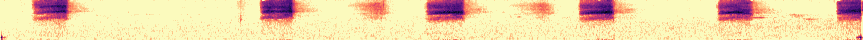
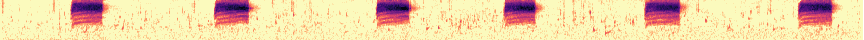
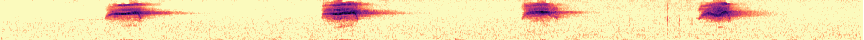
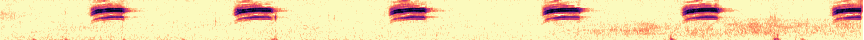
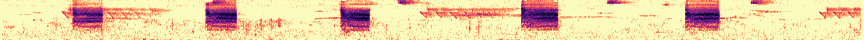
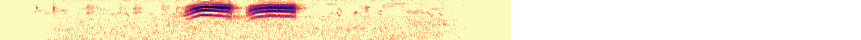
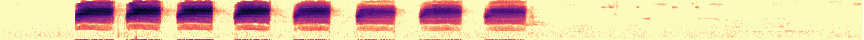
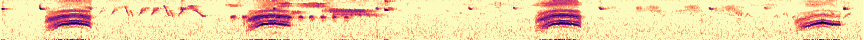
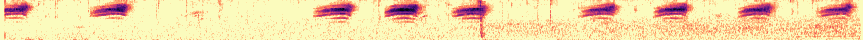

In [ ]:
(search_recs
    .pipe(df_inspect, lambda df: (df.shape,))
    # Filter
    [lambda df: reduce(lambda x, y: x | y, [
        (df.species == 'SPTO') & df.xc_id.isin([127012]),
        (df.species == 'HUVI') & df.xc_id.isin([297120]),
        # (df.species == 'HUVI') & df.xc_id.isin([348987]),
        (df.species == 'WAVI') & df.xc_id.isin([159366]),
        # (df.species == 'WAVI') & df.xc_id.isin([381527]),
        (df.species == 'HETH') & df.xc_id.isin([314303]),
        # (df.species == 'HETH') & df.xc_id.isin([131636]),
        (df.species == 'BEWR') & df.xc_id.isin([163209]),
        # (df.species == 'BEWR') & df.xc_id.isin([141349]),
        (df.species == 'HOWR') & df.xc_id.isin([265810]),
        (df.species == 'GHOW') & df.xc_id.isin([154990]),
        (df.species == 'BANO') & df.xc_id.isin([294969]),
        # (df.species == 'BGGN') & df.xc_id.isin([104672]),
        # (df.species == 'BGGN') & df.xc_id.isin([81059]),
        (df.species == 'LOSH') & df.xc_id.isin([255158]),
        # (df.species == 'LOSH') & df.xc_id.isin([255145]),
    ])]
    .pipe(df_inspect, lambda df: (df.shape,))
    # View
    .pipe(_recs_show,
        scale=3,
    )
    .sort_values(['species'])
)

# XXX Attic

In [ ]:
# BEWR HOWR PAWR
# BGGN
# CATH
# NOMO
# LEGO
# BRCR
# RBNU WBNU PYNU
# OATI CBCH
# HUVI WAVI CAVI
# WEKI
# BLPH SAPH WEWP OSFL ATFL PSFL
# RBSA
# HAWO DOWO NUWO ACWO PIWO NOFL
# RTHA(age) RSHA COHA SSHA AMKE MERL
# COLO

In [ ]:
# WCSP
#   - Around bay area?
(search_recs
    .pipe(df_inspect, lambda df: (df.shape,))
    # Filter
    [lambda df: reduce(lambda x, y: x & y, [
        df.species == 'WCSP',
        df.state.str.lower().str.match(r'.*\b(ca|california)\b.*'),
    ])]
    .pipe(df_inspect, lambda df: (df.shape,))
    # Sort
    .sort_values(['subspecies', 'lat'], ascending=[True, False])
    # .sort_values(['lat'], ascending=False)
    # .sort_values(['lng'], ascending=True)
    # View
    .pipe(_recs_show,
        # scale=3,
    )
    [:500]
)

In [ ]:
# SOSP
#   - Don't know what to do with this one
#   - By subspecies?
(search_recs
    .pipe(df_inspect, lambda df: (df.shape,))
    # Filter
    [lambda df: reduce(lambda x, y: x & y, [
        df.species == 'SOSP',
    ])]
    .pipe(df_inspect, lambda df: (df.shape,))
    # Sort
    [lambda df: ~df.subspecies.isin([''])]
    .sample(100, random_state=0)
    .sort_values(['subspecies'], ascending=[True])
    # View
    .pipe(_recs_show,
        # scale=3,
    )
    [:100]
)

In [ ]:
# BEWR
#   - Don't know what to do with this one
#   - Around US?
#   - Across individuals?
(search_recs
    .pipe(df_inspect, lambda df: (df.shape,))
    # Filter
    [lambda df: reduce(lambda x, y: x & y, [
        df.species == 'BEWR',
    ])]
    .pipe(df_inspect, lambda df: (df.shape,))
    # Sort
    .sample(100, random_state=0)
    .sort_values(['lng'], ascending=[True])
    # View
    .pipe(_recs_show,
        # scale=3,
    )
    [:100]
)